In [54]:
from data_loader import DataLoader
import matplotlib.pyplot as plt

In [55]:
args = {"dataset":"C:/Users/laila/Downloads/BBDD/BBDD"}
DataLoader1 = DataLoader(args)


In [56]:
images = DataLoader1.load_images_from_folder()

287


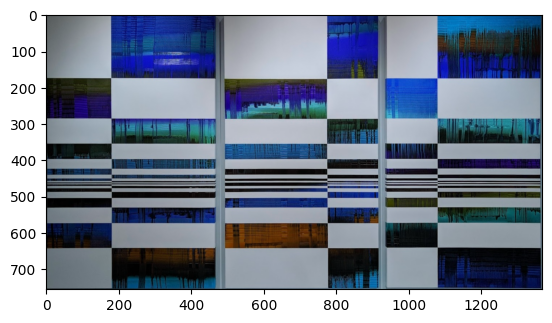

In [57]:
print(len(images))

#Displaying image using plt.imshow() method
plt.imshow(images[0])

In [58]:
# dict histograms
from feature_extractor import FeatureExtractor
FeatureExtractor1 = FeatureExtractor()


images_histograms = []

for img in images:
    dict_img={}
    dict_img['Gray'] = FeatureExtractor1.compute_histogram(img, color_space='Gray', normalize=True,equalize=True)
    dict_img['RGB'] = FeatureExtractor1.compute_histogram(img, color_space='RGB', normalize=True)
    dict_img['HSV'] = FeatureExtractor1.compute_histogram(img, color_space='HSV', normalize=True)
    dict_img['LAB'] = FeatureExtractor1.compute_histogram(img, color_space='LAB', normalize=True)
    dict_img['YCrCb'] = FeatureExtractor1.compute_histogram(img, color_space='YCrCb', normalize=True)
    images_histograms.append(dict_img)


In [59]:
images_histograms

[{'Gray': array([0.0061532 , 0.03511589, 0.06300634, 0.06803856, 0.        ,
         0.07930928, 0.        , 0.08664438, 0.        , 0.08984891,
         0.09142072, 0.        , 0.09306564, 0.        , 0.09318748,
         0.        , 0.09363832, 0.        , 0.08828929, 0.        ,
         0.08256255, 0.08146594, 0.        , 0.07734756, 0.07363127,
         0.        , 0.06865998, 0.06719783, 0.06591845, 0.        ,
         0.06405421, 0.06495587, 0.06229964, 0.06457815, 0.        ,
         0.06356683, 0.06314037, 0.06450504, 0.        , 0.06547981,
         0.0652483 , 0.06668607, 0.        , 0.06728312, 0.06668607,
         0.06617432, 0.        , 0.06530922, 0.06694195, 0.06662516,
         0.        , 0.06641801, 0.06683229, 0.06549199, 0.        ,
         0.06645457, 0.06580879, 0.06561384, 0.        , 0.0637496 ,
         0.06376178, 0.0644563 , 0.        , 0.06226308, 0.063908  ,
         0.06234837, 0.06075219, 0.        , 0.06009423, 0.06115429,
         0.06048414, 0.061

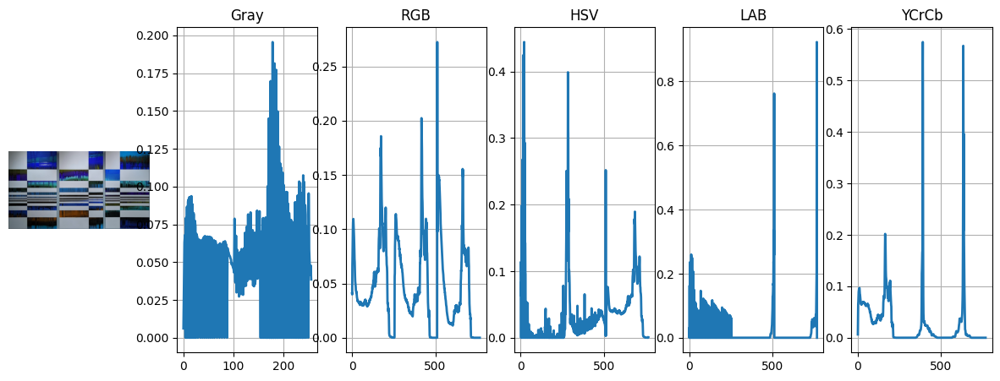

In [60]:
#plotting first image
FeatureExtractor1.plot_histogram(images_histograms[0],images[0])

In [61]:
import pickle

# Save the images_histograms to a pickle file
with open('images_histograms.pkl', 'wb') as file:
    pickle.dump(images_histograms, file, protocol=pickle.HIGHEST_PROTOCOL)

print("Array of images with corresponding dictionaries has been saved to array_of_dicts.pkl")

Array of images with corresponding dictionaries has been saved to array_of_dicts.pkl


In [62]:
with open('images_histograms.pkl', 'rb') as file:
    images_histograms = pickle.load(file)

print(f"Loaded array of images of length:{len(images_histograms)}", images_histograms)

Loaded array of images of length:287 [{'Gray': array([0.0061532 , 0.03511589, 0.06300634, 0.06803856, 0.        ,
       0.07930928, 0.        , 0.08664438, 0.        , 0.08984891,
       0.09142072, 0.        , 0.09306564, 0.        , 0.09318748,
       0.        , 0.09363832, 0.        , 0.08828929, 0.        ,
       0.08256255, 0.08146594, 0.        , 0.07734756, 0.07363127,
       0.        , 0.06865998, 0.06719783, 0.06591845, 0.        ,
       0.06405421, 0.06495587, 0.06229964, 0.06457815, 0.        ,
       0.06356683, 0.06314037, 0.06450504, 0.        , 0.06547981,
       0.0652483 , 0.06668607, 0.        , 0.06728312, 0.06668607,
       0.06617432, 0.        , 0.06530922, 0.06694195, 0.06662516,
       0.        , 0.06641801, 0.06683229, 0.06549199, 0.        ,
       0.06645457, 0.06580879, 0.06561384, 0.        , 0.0637496 ,
       0.06376178, 0.0644563 , 0.        , 0.06226308, 0.063908  ,
       0.06234837, 0.06075219, 0.        , 0.06009423, 0.06115429,
       0.060484

In [63]:
from similarity_calculator import SimilarityCalculator

SimilarityCalculator1=SimilarityCalculator()

# available methods
OPENCV_METHODS = [
            "Correlation",
            "Chi-Squared",
            "Intersection",
            "Hellinger"
        ]

SCIPY_METHODS = [
            "Euclidean",
            "Manhattan",
            "Chebyshev"
]

similarity_results = SimilarityCalculator1.compute_similarity([images_histograms[2],images_histograms[6]],methodName=OPENCV_METHODS[3])
similarity_results


[(0.49996156137425, 'RGB'),
 (0.5119092400562231, 'HSV'),
 (0.5345517588303257, 'YCrCb'),
 (0.7227760075980663, 'LAB'),
 (0.801325898259897, 'Gray')]

In [64]:
# Load the validation set
args2 = {"dataset":"C:/Users/laila/Downloads/qsd1_w1/qsd1_w1"}
DataLoader2 = DataLoader(args2)

In [65]:
validation_images = DataLoader2.load_images_from_folder()

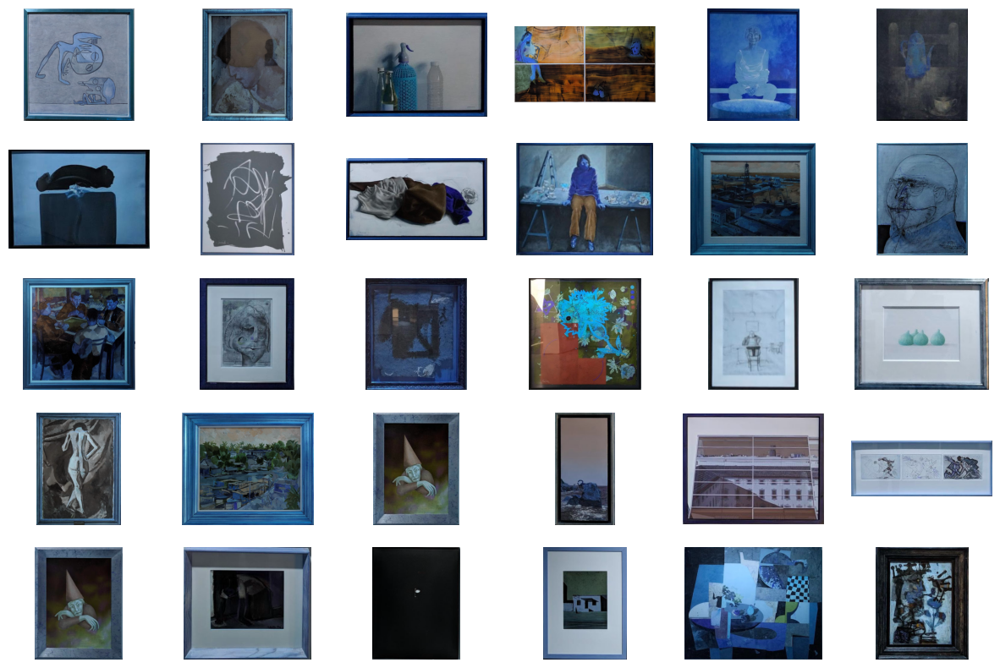

In [66]:
fig, axes = plt.subplots(nrows=5, ncols=6, figsize=(15, 10))

# Plot each image in the grid
for i, ax in enumerate(axes.flat):
    ax.imshow(validation_images[i], cmap='gray')
    ax.axis('off')

plt.show()

In [67]:
validation_images_histograms = []

for validation_image in validation_images:
    dict_img={}
    dict_img['Gray'] = FeatureExtractor1.compute_histogram(validation_image, color_space='Gray', normalize=True,equalize=True)
    dict_img['RGB'] = FeatureExtractor1.compute_histogram(validation_image, color_space='RGB', normalize=True)
    dict_img['HSV'] = FeatureExtractor1.compute_histogram(validation_image, color_space='HSV', normalize=True)
    dict_img['LAB'] = FeatureExtractor1.compute_histogram(validation_image, color_space='LAB', normalize=True)
    dict_img['YCrCb'] = FeatureExtractor1.compute_histogram(validation_image, color_space='YCrCb', normalize=True)
    validation_images_histograms.append(dict_img)

In [68]:
print(len(validation_images_histograms))

30


In [69]:
len(images_histograms)

287

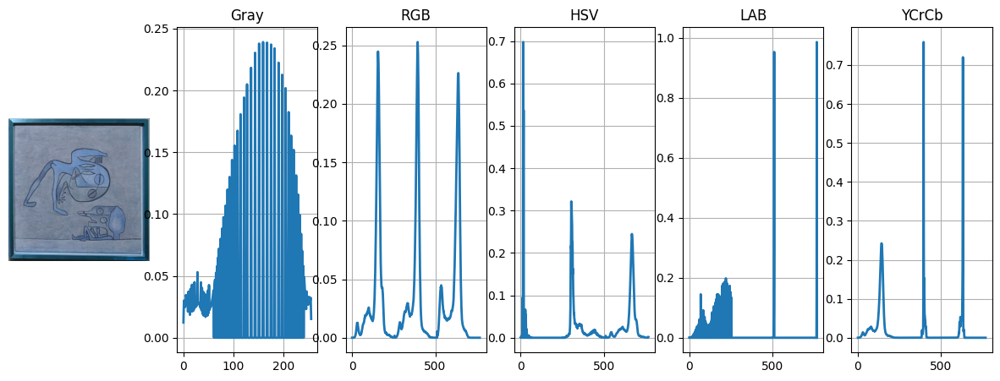

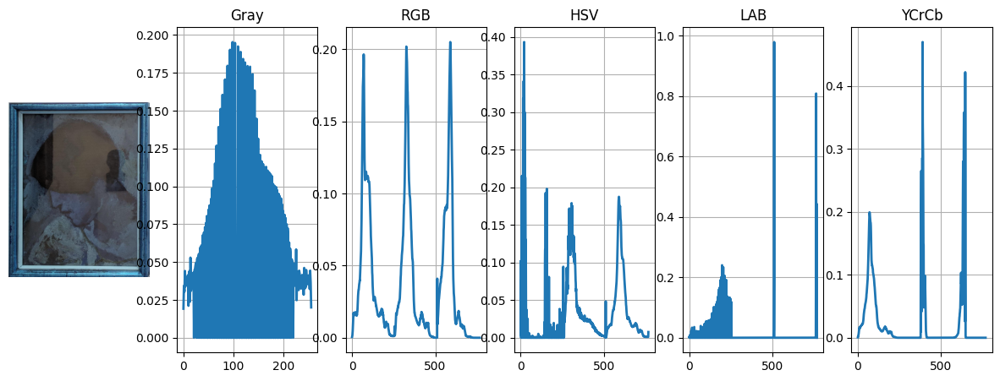

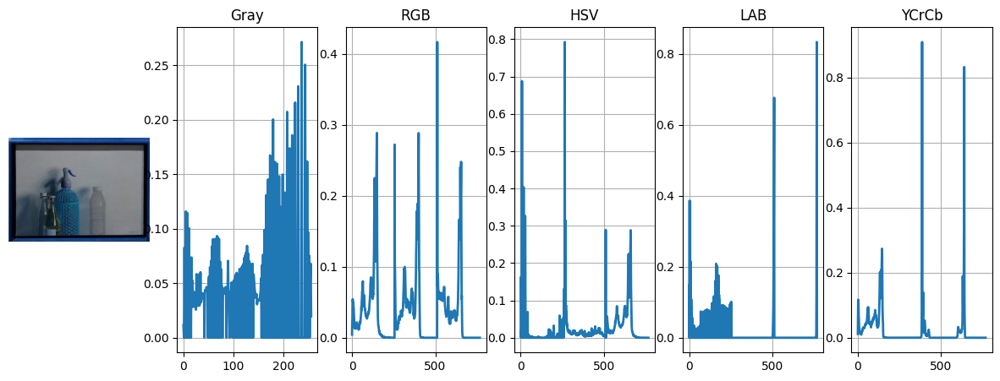

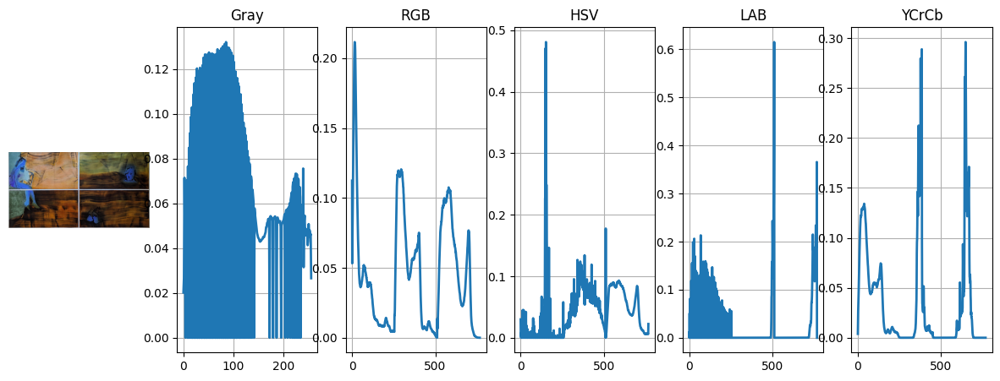

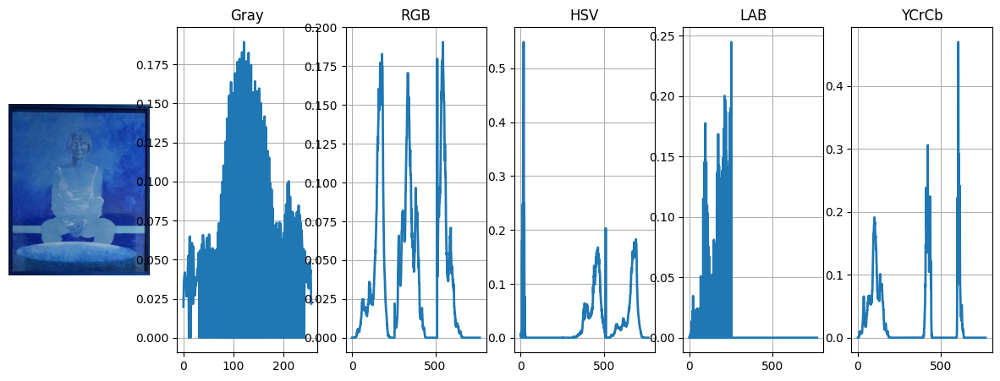

...

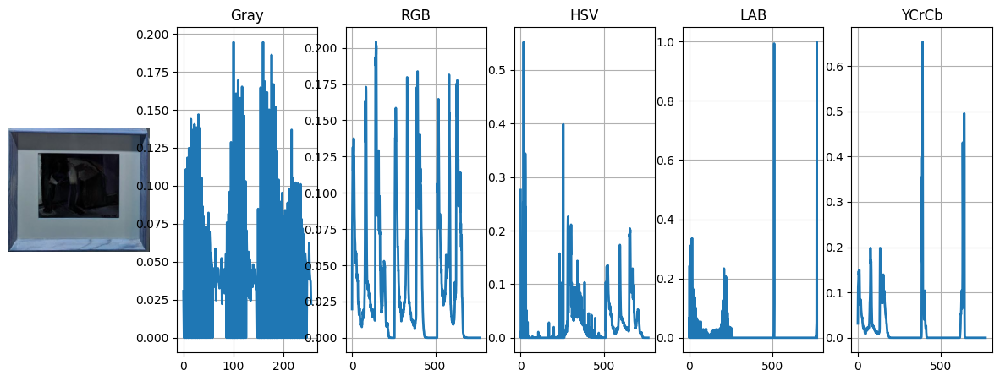

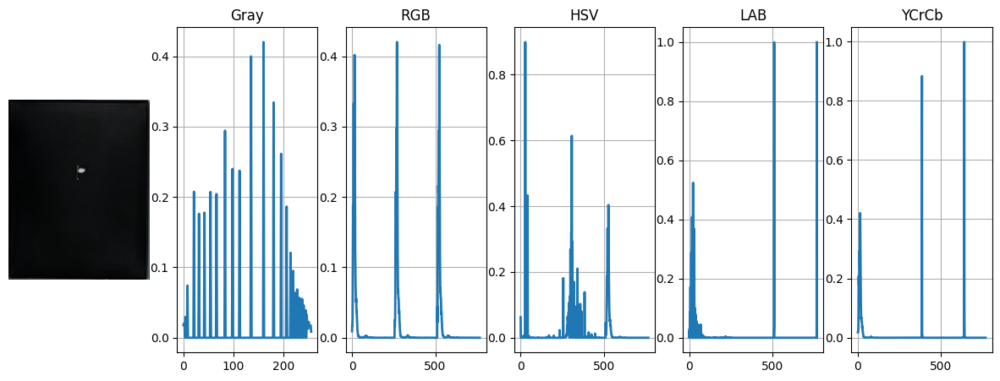

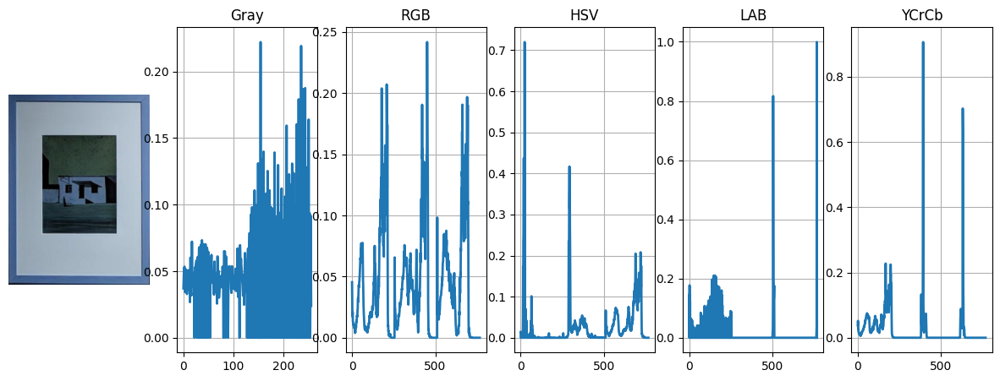

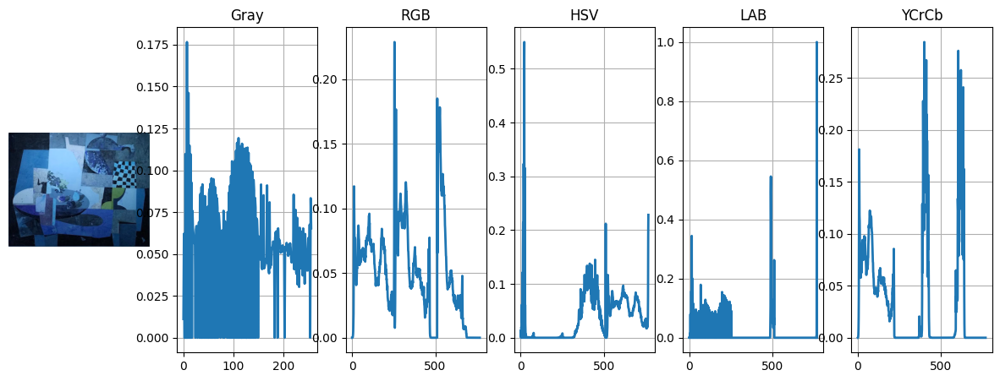

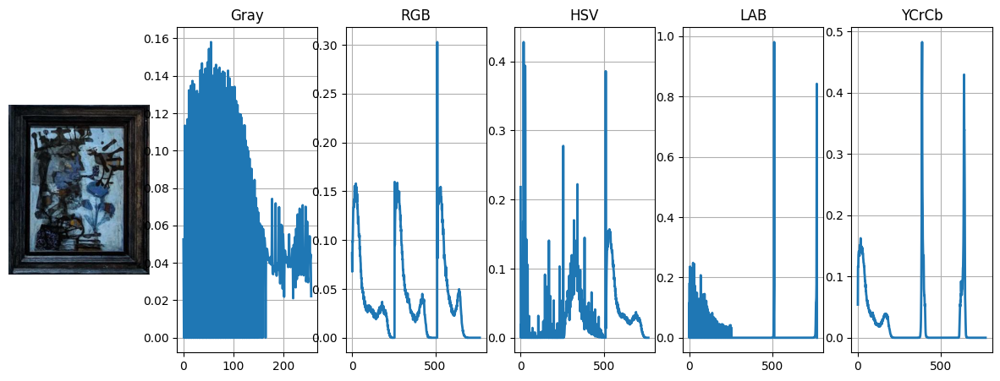

In [70]:
for i in range (30):
    FeatureExtractor1.plot_histogram(validation_images_histograms[i],validation_images[i])

In [71]:
print(OPENCV_METHODS[0])
#SCIPY_METHODS[2]

Correlation


In [98]:
# Get similarity metrics for validation set

validation_results = []
for validation_image_hist in validation_images_histograms:
    results = []
    for image_hist in images_histograms:
        try:
            similarity = SimilarityCalculator1.compute_similarity(
                [validation_image_hist, image_hist], methodName=OPENCV_METHODS[3]
            )
            results.append(similarity)
        except Exception as e:
            print(f"Error computing similarity: {e}")
    
    validation_results.append(results)

In [73]:
print(len(validation_results))
print(len(validation_results[0]))

30
287


In [74]:
print(validation_results[0])
print(validation_results[1])

[[(np.float32(10.291596), 'LAB'), (np.float32(13.712357), 'Gray'), (np.float32(22.205036), 'YCrCb'), (np.float32(26.289957), 'HSV'), (np.float32(36.121895), 'RGB')], [(np.float32(8.594734), 'Gray'), (np.float32(10.602842), 'LAB'), (np.float32(14.450991), 'YCrCb'), (np.float32(20.092855), 'HSV'), (np.float32(26.554491), 'RGB')], [(np.float32(10.45574), 'LAB'), (np.float32(11.9946995), 'Gray'), (np.float32(13.533693), 'YCrCb'), (np.float32(18.840946), 'HSV'), (np.float32(19.273367), 'RGB')], [(np.float32(10.704042), 'LAB'), (np.float32(13.590854), 'Gray'), (np.float32(19.057348), 'YCrCb'), (np.float32(26.976212), 'HSV'), (np.float32(34.207222), 'RGB')], [(np.float32(5.1609097), 'LAB'), (np.float32(11.977325), 'Gray'), (np.float32(21.268345), 'YCrCb'), (np.float32(21.656141), 'HSV'), (np.float32(28.422117), 'RGB')], [(np.float32(5.669886), 'LAB'), (np.float32(11.835037), 'Gray'), (np.float32(15.516033), 'YCrCb'), (np.float32(18.516396), 'HSV'), (np.float32(26.567707), 'RGB')], [(np.float3

In [99]:
from retrieval_system import RetrievalSystem
RetrievalSystem1=RetrievalSystem()
# Color scales to search
#color_names = ['RGB', 'Gray', 'HSV', 'YCrCb', 'LAB']
color_names = ['Gray']

method = "Hellinger"  # or "Intersection", "Euclidean", etc.
K = 5  # Number of top values to return
final=[]
for i in range(len(validation_results)):
    top_k_indices_dict = {color_name: RetrievalSystem1.search_top_k_values(validation_results[i], color_name, method, K) for color_name in color_names}
    #final.append(RetrievalSystem1.search_top_k_values(validation_results[i], color_names[0], method, K))
    final.append(top_k_indices_dict['Gray'])
    print(i,top_k_indices_dict)
#print(final)

0 {'Gray': [191, 217, 60, 211, 150]}
1 {'Gray': [23, 127, 191, 78, 125]}
2 {'Gray': [197, 154, 56, 228, 38]}
3 {'Gray': [113, 10, 86, 81, 195]}
4 {'Gray': [265, 127, 125, 84, 43]}
5 {'Gray': [156, 140, 12, 150, 280]}
6 {'Gray': [152, 81, 137, 200, 85]}
7 {'Gray': [93, 160, 78, 96, 149]}
8 {'Gray': [127, 248, 156, 152, 58]}
9 {'Gray': [12, 126, 23, 127, 160]}
10 {'Gray': [4, 152, 127, 72, 275]}
11 {'Gray': [78, 154, 197, 119, 96]}
12 {'Gray': [140, 187, 225, 276, 34]}
13 {'Gray': [160, 152, 94, 197, 44]}
14 {'Gray': [160, 93, 140, 59, 157]}
15 {'Gray': [225, 149, 166, 265, 12]}
16 {'Gray': [58, 168, 152, 127, 156]}
17 {'Gray': [7, 58, 125, 154, 229]}
18 {'Gray': [81, 93, 84, 12, 154]}
19 {'Gray': [127, 192, 249, 276, 106]}
20 {'Gray': [61, 148, 150, 154, 152]}
21 {'Gray': [275, 152, 205, 81, 137]}
22 {'Gray': [78, 154, 27, 127, 58]}
23 {'Gray': [205, 58, 12, 232, 111]}
24 {'Gray': [225, 127, 237, 132, 148]}
25 {'Gray': [127, 168, 3, 225, 23]}
26 {'Gray': [219, 33, 156, 168, 29]}
27 {'Gr

In [76]:
file_path = 'C:/Users/laila/Downloads/qsd1_w1/qsd1_w1/gt_corresps.pkl'

with open(file_path, 'rb') as file:
    ground_truth = pickle.load(file)


In [100]:
final

[[191, 217, 60, 211, 150],
 [23, 127, 191, 78, 125],
 [197, 154, 56, 228, 38],
 [113, 10, 86, 81, 195],
 [265, 127, 125, 84, 43],
 [156, 140, 12, 150, 280],
 [152, 81, 137, 200, 85],
 [93, 160, 78, 96, 149],
 [127, 248, 156, 152, 58],
 [12, 126, 23, 127, 160],
 [4, 152, 127, 72, 275],
 [78, 154, 197, 119, 96],
 [140, 187, 225, 276, 34],
 [160, 152, 94, 197, 44],
 [160, 93, 140, 59, 157],
 [225, 149, 166, 265, 12],
 [58, 168, 152, 127, 156],
 [7, 58, 125, 154, 229],
 [81, 93, 84, 12, 154],
 [127, 192, 249, 276, 106],
 [61, 148, 150, 154, 152],
 [275, 152, 205, 81, 137],
 [78, 154, 27, 127, 58],
 [205, 58, 12, 232, 111],
 [225, 127, 237, 132, 148],
 [127, 168, 3, 225, 23],
 [219, 33, 156, 168, 29],
 [150, 60, 152, 197, 168],
 [125, 96, 149, 81, 244],
 [276, 158, 260, 10, 78]]

In [101]:
from evaluator import Evaluator
Evaluator1 = Evaluator()
Evaluator1.mapk(ground_truth,final,k=5)

np.float64(0.0)